In [1]:
import pandas as pd

In [3]:
df_original=pd.read_csv("/content/IMDB Dataset.csv")

In [4]:
df_original.head()

,review,sentiment
0,One of the other reviewers has mentioned that ...,positive
1,A wonderful little production. <br /><br />The...,positive
2,I thought this was a wonderful way to spend ti...,positive
3,Basically there's a family where a little boy ...,negative
4,"Petter Mattei's ""Love in the Time of Money"" is...",positive


In [5]:
df_original.shape[0]

50000

In [6]:
df_original.columns

Index(['review', 'sentiment'], dtype='object')

In [7]:
df_original.columns.to_list()

['review', 'sentiment']

In [8]:
print(df_original.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   review     50000 non-null  object
 1   sentiment  50000 non-null  object
dtypes: object(2)
memory usage: 781.4+ KB
None


In [10]:
print(df_original.describe())

                                                   review sentiment
count                                               50000     50000
unique                                              49582         2
top     Loved today's show!!! It was a variety and not...  positive
freq                                                    5     25000


In [11]:
col_list=df_original.columns.to_list()

In [12]:
print(col_list)

['review', 'sentiment']


In [15]:
for col in col_list:
  print("**"*30)
  print(f"The different values present in the column '{col}' and their count is:")
  print(df_original[col].value_counts())

************************************************************
The different values present in the column 'review' and their count is:
review
Loved today's show!!! It was a variety and not solely cooking (which would have been great too). Very stimulating and captivating, always keeping the viewer peeking around the corner to see what was coming up next. She is as down to earth and as personable as you get, like one of us which made the show all the more enjoyable. Special guests, who are friends as well made for a nice surprise too. Loved the 'first' theme and that the audience was invited to play along too. I must admit I was shocked to see her come in under her time limits on a few things, but she did it and by golly I'll be writing those recipes down. Saving time in the kitchen means more time with family. Those who haven't tuned in yet, find out what channel and the time, I assure you that you won't be disappointed.                                                                    

Descriptive Stats

In [16]:
import matplotlib.pyplot as plt
import seaborn as sns

In [17]:
data = {
    'ID': [1, 2, 3, 4, 5],
    'Sentence': [
        'Machine learning is fun.',
        'Python is a powerful programming language.',
        'Data science involves statistics and coding.',
        'Snowflake is great for data warehousing.',
        'Pandas makes data analysis easier.'
    ]
}

In [18]:
df_test=pd.DataFrame(data)

In [20]:
df_test

,ID,Sentence
0,1,Machine learning is fun.
1,2,Python is a powerful programming language.
2,3,Data science involves statistics and coding.
3,4,Snowflake is great for data warehousing.
4,5,Pandas makes data analysis easier.


In [21]:
df_test["sentence_char_len"]=df_test["Sentence"].apply(len)
df_test["sentence_word_len"]=df_test["Sentence"].apply(lambda X: len(X.split()))

In [24]:
print(df_test)

   ID                                      Sentence  sentence_char_len  \
0   1                      Machine learning is fun.                 24   
1   2    Python is a powerful programming language.                 42   
2   3  Data science involves statistics and coding.                 44   
3   4      Snowflake is great for data warehousing.                 40   
4   5            Pandas makes data analysis easier.                 34   

   sentence_word_len  
0                  4  
1                  6  
2                  6  
3                  6  
4                  5  


In [25]:
print(len("Hello Vivek."))

12


In [30]:
df_original["review_char_length"]=df_original["review"].apply(len)
df_original["review_word_length"]=df_original["review"].apply(lambda X:len(X.split()))

In [31]:
df_original[["review_char_length", "review_word_length"]].describe()

,review_char_length,review_word_length
count,50000.000000,50000.000000
mean,1309.431020,231.156940
std,989.728014,171.343997
min,32.000000,4.000000
25%,699.000000,126.000000
50%,970.000000,173.000000
75%,1590.250000,280.000000
max,13704.000000,2470.000000


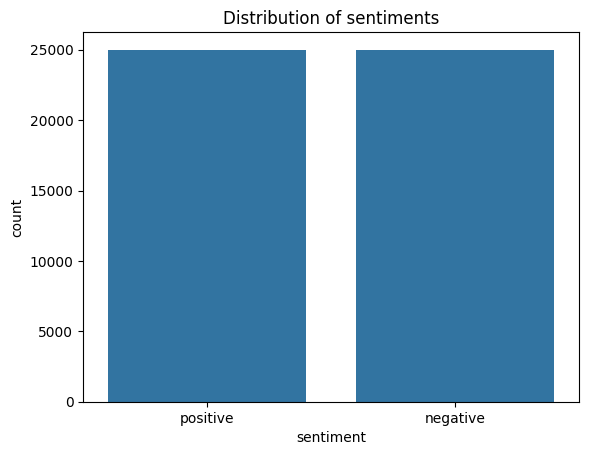

In [32]:
#Sentiment Distribution

sns.countplot(x="sentiment", data=df_original)
plt.title("Distribution of sentiments")
plt.show()

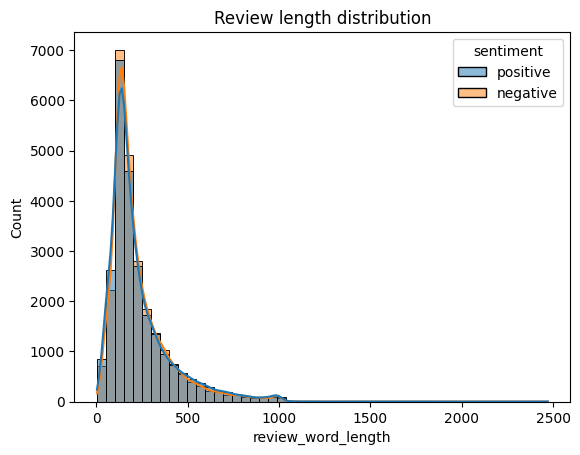

In [35]:
#Histogram to review word lengths

sns.histplot(data=df_original, x="review_word_length", bins=50, hue='sentiment', kde=True)
plt.title("Review length distribution")
plt.show()

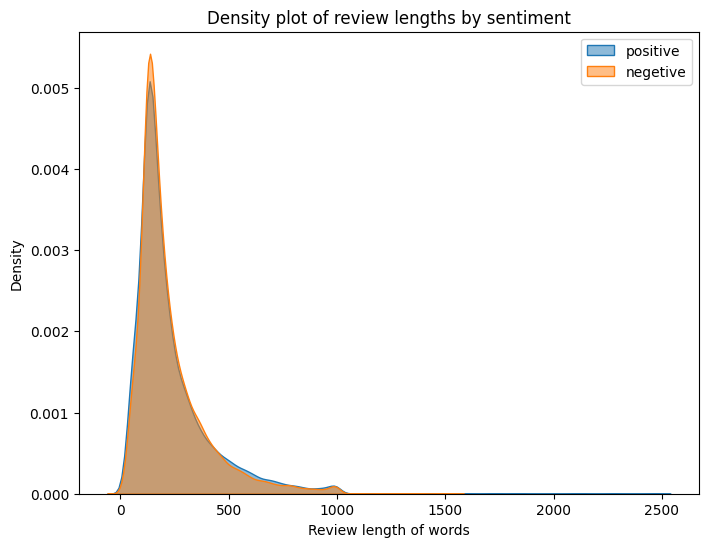

In [37]:
plt.figure(figsize=(8, 6))
sns.kdeplot(df_original[df_original["sentiment"]=='positive']['review_word_length'], label='positive', fill=True, alpha=0.5)
sns.kdeplot(df_original[df_original["sentiment"]=='negative']['review_word_length'], label='negetive', fill=True, alpha=0.5)
plt.title("Density plot of review lengths by sentiment")
plt.xlabel("Review length of words")
plt.ylabel("Density")
plt.legend()
plt.show()

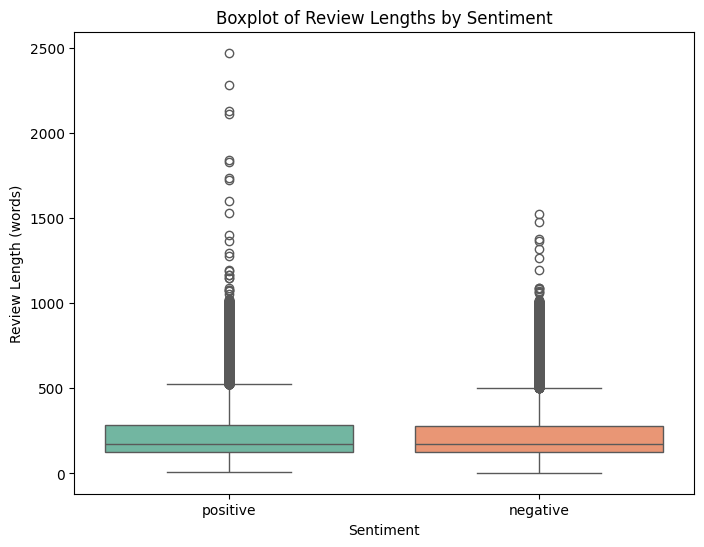

In [39]:
plt.figure(figsize=(8,6))
sns.boxplot(x="sentiment", y="review_word_length", data=df_original, palette="Set2", hue="sentiment")
plt.title("Boxplot of Review Lengths by Sentiment")
plt.xlabel("Sentiment")
plt.ylabel("Review Length (words)")
plt.show()

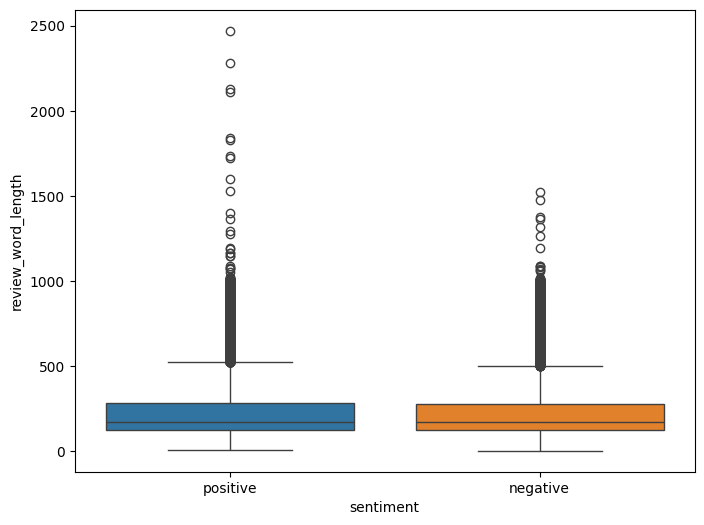

In [43]:
plt.figure(figsize=(8, 6))
sns.boxplot(x='sentiment', y='review_word_length', data=df_original, hue='sentiment')
plt.show()

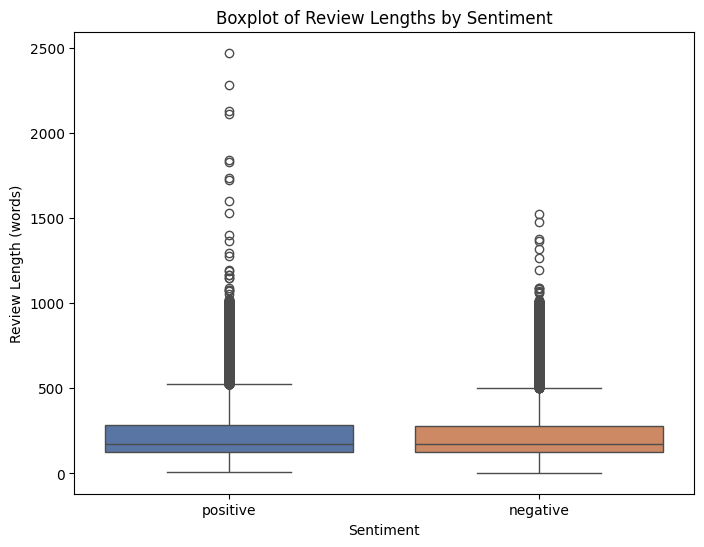

In [44]:
plt.figure(figsize=(8,6))
sns.boxplot(x="sentiment", y="review_word_length", data=df_original, palette="deep", hue="sentiment")
plt.title("Boxplot of Review Lengths by Sentiment")
plt.xlabel("Sentiment")
plt.ylabel("Review Length (words)")
plt.show()

In [45]:
import numpy as np

In [46]:
Q1=df_original['review_word_length'].quantile(0.25)
Q3=df_original['review_word_length'].quantile(0.75)

IQR=Q3-Q1

Lower_bound=Q1-(1.5*IQR)
Upper_Bound=Q3+(1.5*IQR)

In [51]:
print(Lower_bound)
print(Upper_Bound)

-105.0
511.0


In [47]:
df_original_outliers=df_original[(df_original['review_word_length']<Lower_bound) |(df_original['review_word_length']>Upper_Bound)]

len(df_original_outliers)

3708

In [48]:
df_freefrom_outliers=df_original[(df_original['review_word_length']>Lower_bound) &(df_original['review_word_length']<Upper_Bound)]


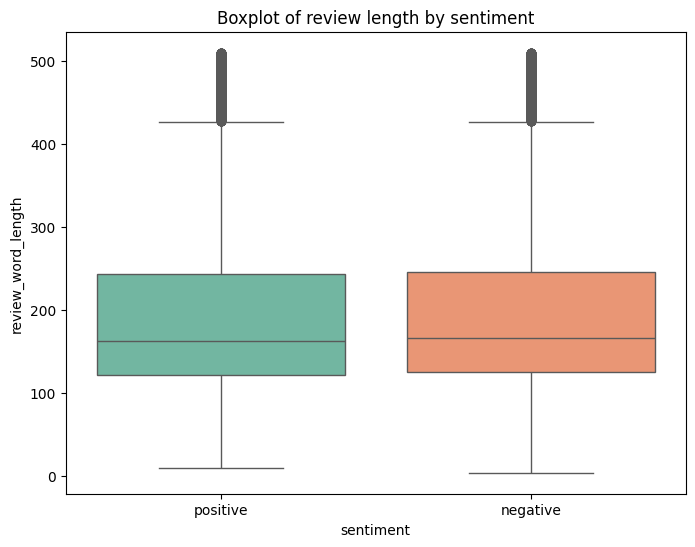

In [56]:
plt.figure(figsize=(8, 6))
sns.boxplot(x='sentiment', y='review_word_length', data=df_freefrom_outliers, palette='Set2', hue='sentiment')
plt.title("Boxplot of review length by sentiment")
plt.show()

In [57]:
from collections import Counter
import re
import nltk
from nltk.corpus import stopwords

In [67]:
nltk.download('stopwords')
stop_words=set(stopwords.words('english'))

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [62]:
len(stop_words)

198

In [63]:
stop_words

{'a',
 'about',
 'above',
 'after',
 'again',
 'against',
 'ain',
 'all',
 'am',
 'an',
 'and',
 'any',
 'are',
 'aren',
 "aren't",
 'as',
 'at',
 'be',
 'because',
 'been',
 'before',
 'being',
 'below',
 'between',
 'both',
 'but',
 'by',
 'can',
 'couldn',
 "couldn't",
 'd',
 'did',
 'didn',
 "didn't",
 'do',
 'does',
 'doesn',
 "doesn't",
 'doing',
 'don',
 "don't",
 'down',
 'during',
 'each',
 'few',
 'for',
 'from',
 'further',
 'had',
 'hadn',
 "hadn't",
 'has',
 'hasn',
 "hasn't",
 'have',
 'haven',
 "haven't",
 'having',
 'he',
 "he'd",
 "he'll",
 "he's",
 'her',
 'here',
 'hers',
 'herself',
 'him',
 'himself',
 'his',
 'how',
 'i',
 "i'd",
 "i'll",
 "i'm",
 "i've",
 'if',
 'in',
 'into',
 'is',
 'isn',
 "isn't",
 'it',
 "it'd",
 "it'll",
 "it's",
 'its',
 'itself',
 'just',
 'll',
 'm',
 'ma',
 'me',
 'mightn',
 "mightn't",
 'more',
 'most',
 'mustn',
 "mustn't",
 'my',
 'myself',
 'needn',
 "needn't",
 'no',
 'nor',
 'not',
 'now',
 'o',
 'of',
 'off',
 'on',
 'once',
 'on

In [68]:
text="Data Science is FUN!"
text_lower=re.findall(r'\b[a-z]+\b', text.lower())

In [69]:
print(text_lower)

['data', 'science', 'is', 'fun']


In [70]:
result=[w for w in text_lower if w not in stop_words]

In [71]:
print(result)

['data', 'science', 'fun']


In [74]:
print(text.apply('Data'))

AttributeError: 'str' object has no attribute 'apply'

In [72]:
def preprocess_text(text):
  words=re.findall(r'\b[a-z]+\b', text.lower())
  return [w for w in words if w not in stop_words and w!="br"]

In [76]:
pos_rev=df_original[df_original["sentiment"]=='positive']['review'].apply(preprocess_text)
neg_rev=df_original[df_original["sentiment"]=='negative']['review'].apply(preprocess_text)

In [77]:
print(pos_rev)

0        [one, reviewers, mentioned, watching, oz, epis...
1        [wonderful, little, production, filming, techn...
2        [thought, wonderful, way, spend, time, hot, su...
4        [petter, mattei, love, time, money, visually, ...
5        [probably, time, favorite, movie, story, selfl...
                               ...                        
49983    [loved, fan, original, series, always, wondere...
49985    [imaginary, heroes, clearly, best, film, year,...
49989    [got, one, weeks, ago, love, modern, light, fi...
49992    [john, garfield, plays, marine, blinded, grena...
49995    [thought, movie, right, good, job, creative, o...
Name: review, Length: 25000, dtype: object


In [78]:
pos_words=[word for review in pos_rev for word in review]
neg_words=[word for review in neg_rev for word in review]

In [79]:
print(pos_words)

['one', 'reviewers', 'mentioned', 'watching', 'oz', 'episode', 'hooked', 'right', 'exactly', 'happened', 'first', 'thing', 'struck', 'oz', 'brutality', 'unflinching', 'scenes', 'violence', 'set', 'right', 'word', 'go', 'trust', 'show', 'faint', 'hearted', 'timid', 'show', 'pulls', 'punches', 'regards', 'drugs', 'sex', 'violence', 'hardcore', 'classic', 'use', 'word', 'called', 'oz', 'nickname', 'given', 'oswald', 'maximum', 'security', 'state', 'penitentary', 'focuses', 'mainly', 'emerald', 'city', 'experimental', 'section', 'prison', 'cells', 'glass', 'fronts', 'face', 'inwards', 'privacy', 'high', 'agenda', 'em', 'city', 'home', 'many', 'aryans', 'muslims', 'gangstas', 'latinos', 'christians', 'italians', 'irish', 'scuffles', 'death', 'stares', 'dodgy', 'dealings', 'shady', 'agreements', 'never', 'far', 'away', 'would', 'say', 'main', 'appeal', 'show', 'due', 'fact', 'goes', 'shows', 'dare', 'forget', 'pretty', 'pictures', 'painted', 'mainstream', 'audiences', 'forget', 'charm', 'for

AttributeError: 'int' object has no attribute 'head'

In [81]:
pos_common=Counter(pos_words).most_common(20)
neg_common=Counter(neg_words).most_common(20)

In [82]:
print("Most common words in positive review:", pos_common)
print("Most common words in negative review:", neg_common)

Most common words in positive review: [('film', 42110), ('movie', 37854), ('one', 27320), ('like', 17714), ('good', 15025), ('great', 12964), ('story', 12934), ('time', 12752), ('well', 12729), ('see', 12276), ('also', 10793), ('really', 10739), ('would', 10595), ('even', 9617), ('first', 9230), ('much', 9201), ('people', 8719), ('love', 8692), ('best', 8510), ('get', 8285)]
Most common words in negative review: [('movie', 50117), ('film', 37595), ('one', 26283), ('like', 22458), ('even', 15254), ('good', 14728), ('bad', 14726), ('would', 14007), ('time', 12358), ('really', 12355), ('see', 10753), ('story', 10185), ('get', 10136), ('much', 10117), ('people', 9469), ('make', 9355), ('could', 9300), ('made', 8801), ('well', 8539), ('first', 8353)]


In [83]:
from sklearn.feature_extraction.text import CountVectorizer

In [84]:
def get_top_ngrams(words_list, ngram_range=(2, 2), top_n=10):
  vec=CountVectorizer(ngram_range=ngram_range)
  bag=vec.fit_transform([' '.join(words_list)])
  sum_words=bag.sum(axis=0)
  words_freq=[(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
  sorted_words=sorted(words_freq, key=lambda X:X[1], reverse=True)
  return sorted_words[:top_n]


In [85]:
print("Top Positive Bigrams:", get_top_ngrams(pos_words, (2, 2)))
print("Top Negetive Bigrams:", get_top_ngrams(neg_words, (2, 2)))

Top Positive Bigrams: [('one best', np.int64(1680)), ('even though', np.int64(1099)), ('ever seen', np.int64(976)), ('first time', np.int64(960)), ('new york', np.int64(855)), ('special effects', np.int64(806)), ('see movie', np.int64(784)), ('must see', np.int64(778)), ('real life', np.int64(761)), ('years ago', np.int64(741))]
Top Negetive Bigrams: [('ever seen', np.int64(1734)), ('special effects', np.int64(1443)), ('waste time', np.int64(1437)), ('looks like', np.int64(1234)), ('low budget', np.int64(1229)), ('much better', np.int64(1009)), ('one worst', np.int64(964)), ('look like', np.int64(945)), ('bad movie', np.int64(927)), ('year old', np.int64(914))]


In [86]:
print("Top Positive Trigrams:", get_top_ngrams(pos_words, (3, 3)))
print("Top Negative Trigrams:", get_top_ngrams(neg_words, (3, 3)))

Top Positive Trigrams: [('new york city', np.int64(195)), ('world war ii', np.int64(167)), ('one best movies', np.int64(144)), ('based true story', np.int64(135)), ('movie ever seen', np.int64(134)), ('one best films', np.int64(132)), ('first time saw', np.int64(115)), ('movies ever seen', np.int64(112)), ('films ever made', np.int64(99)), ('well worth watching', np.int64(95))]
Top Negative Trigrams: [('worst movie ever', np.int64(459)), ('movie ever seen', np.int64(394)), ('one worst movies', np.int64(311)), ('worst movies ever', np.int64(282)), ('movies ever seen', np.int64(268)), ('worst film ever', np.int64(202)), ('waste time money', np.int64(181)), ('one worst films', np.int64(169)), ('film ever seen', np.int64(166)), ('movie ever made', np.int64(155))]


In [87]:
from wordcloud import WordCloud

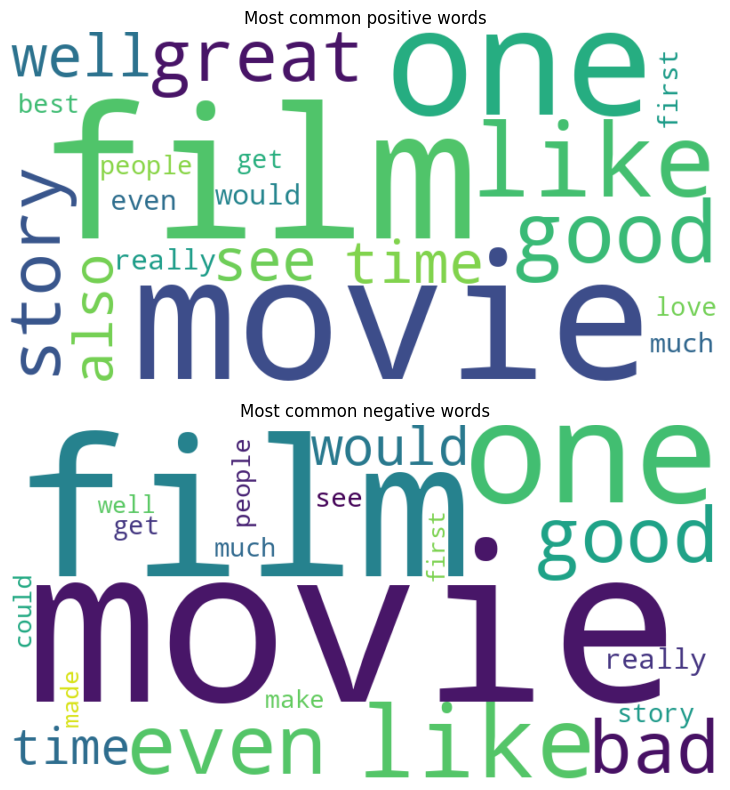

In [90]:
pos_common_300=Counter(pos_words).most_common(300)
neg_common_300=Counter(neg_words).most_common(300)

pos_word_dict=dict(pos_common)
neg_word_dict=dict(neg_common)

pos_wordcloud=WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(pos_word_dict)
neg_wordcloud=WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(neg_word_dict)

plt.figure(figsize=(20, 8))

plt.subplot(2, 1, 1)
plt.imshow(pos_wordcloud, interpolation='bilinear')
plt.title("Most common positive words")
plt.axis('off')


plt.subplot(2, 1, 2)
plt.imshow(neg_wordcloud, interpolation='bilinear')
plt.title("Most common negative words")
plt.axis('off')

plt.tight_layout()
plt.show()